# Tropical Gaussians

- Proseminar *Ultrametric Data Analysis* SoSe25
- A Presentation by **Soroush Yaghoubi**

# Introduction

> **GOAL**: "Tropical Gaussians"

1. reviewing p-adics *(only the parts we care about)*
2. p-adics $\longrightarrow$ Tropical Math
3. a cool usecase: *Neural Networks*
4. reviewing nice properties of Gaussian distributions
5. $\longrightarrow$ a distribution over the p-adic tropicalization



## 1. Reviewing $p$-adics
<div>
    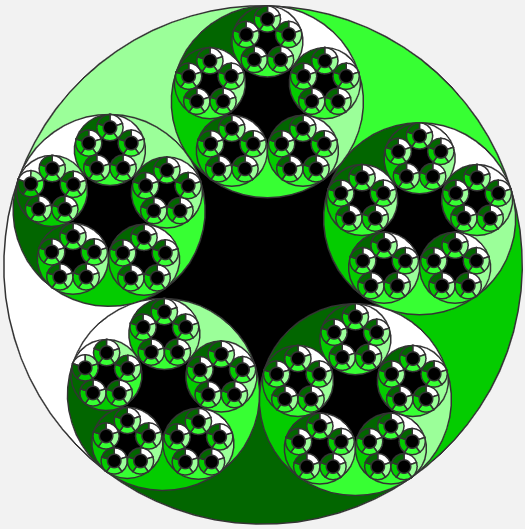
    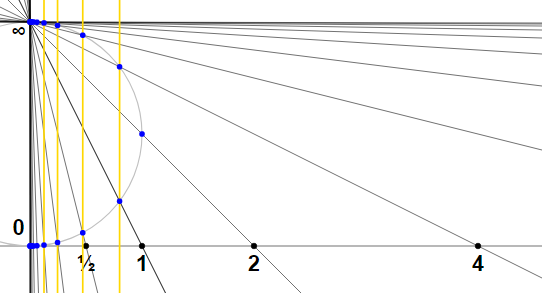
    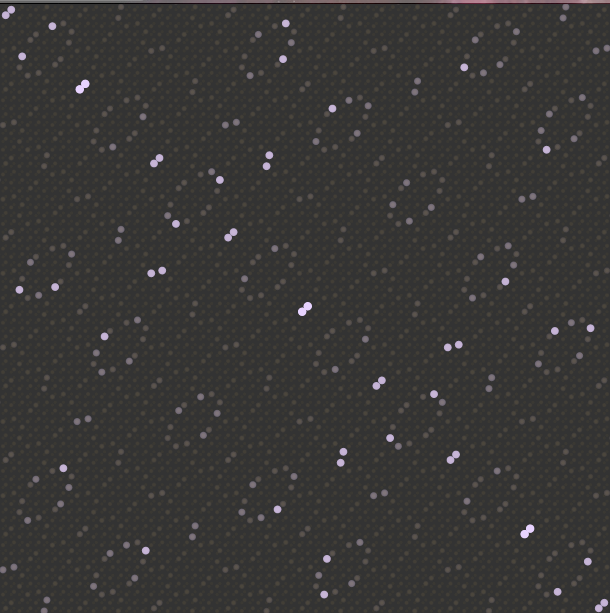
    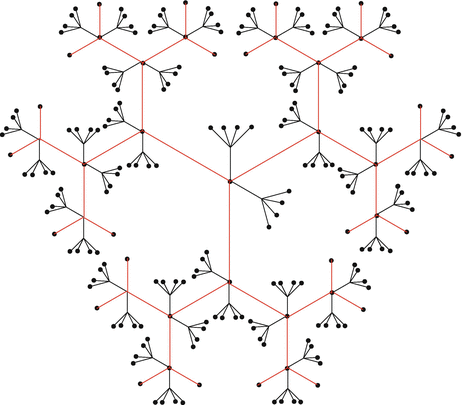
</div>

## *Picking the Right Visualization*

## *Why don't the other visualizations work?*

## the _valuation_ function

$$v_3(36)=v_3(3^{\boxed{2}} \times 4)=2$$

## Some Details

$$v_p(-\frac{15}{36}) = v_3(\frac{3^1 \times 5}{3^2 \times 4}) = v_p(3^{\boxed{-1}} \times \frac{5}{4})=-1$$

___

$$v_p(0) := +\infty$$


# 2. Tropicalization

- Setup

$$x=p^{v_p(x)} \times a$$
$$y=p^{v_p(y)} \times b$$

___

$$X := v_p(x)$$
$$Y := v_p(y)$$

___

$$m:=\min(v_p(x), v_p(y))$$
$$M:=\max(v_p(x), v_p(y))$$

## *Two Nice Properties*

1. $$\qquad v_p(x y) \qquad \;\;\;\;\, = \qquad v_p(p^{\boxed{v_p(x) + v_p(y)}} \times ab) \qquad = \qquad v_p(x)+v_p(y)$$
2. $$v_p(x+y) \qquad = \qquad v_p(p^{v_p(x)}a + p^{v_p(y)}b) \qquad \qquad = \qquad \qquad ??$$

## *What to do With the Second Property?*


case $v_p(x) \neq v_p(y) \qquad \longrightarrow$ $$v_p(\;\; p^{m} (\boxed{p^{M-m}a + b}) \;\;)= \qquad m$$

___

case $v_p(x) = v_p(y) \qquad \longrightarrow$ $$v_p(\;\; p^{m} (\boxed{a + b})\;\;) \qquad \;\,\geq \qquad m$$


## *a revealing example*

$$x^2y+3y+y^5=0$$
$$v_3(x^2y + 3y + y^5)=v_3(0)=\infty$$

___

$$v_3(x^2y)=v_3(x \times x \times y)=X+X+Y=\boxed{2X+Y}$$ 
$$v_3(3y)=v_3(3) + Y = \boxed{1+Y}$$
$$v_3(y^5)=v_3(Y+Y+Y+Y+Y) = \boxed{5Y}$$
___

$$\min(2X+Y, 1+Y, 5Y)$$




#### Example 1: The whole plot

In [46]:
import plotly.io as pio
pio.renderers.default = "notebook_connected"

import numpy as np
import plotly.graph_objects as go

x = np.linspace(-2, 2, 800)
y = np.linspace(-2, 3, 1000)
X, Y = np.meshgrid(x, y)

functions = [
    2*X + Y,
    1 + Y,
    5*Y
]

stack = np.stack(functions)
Z = np.min(stack, axis=0)
active = np.argmin(stack, axis=0)
mask = np.zeros_like(active, dtype=bool)
mask[1:, :] |= active[1:, :] != active[:-1, :]
mask[:, 1:] |= active[:, 1:] != active[:, :-1]

fig = go.Figure()

fig.add_trace(go.Surface(
    x=x, y=y, z=Z,
    colorscale="Viridis",
    showscale=True,
    opacity=0.8
))

fig.add_trace(go.Scatter3d(
    x=X[mask], y=Y[mask], z=Z[mask],
    mode='markers',
    marker=dict(size=2, color='black'),
    name="Bends"
))

fig.update_layout(scene=dict(
    xaxis_title='X', yaxis_title='Y', zaxis_title='Z'
))

fig.update_layout(
    height=650,
)

fig.show()


#### Example 1: The contour plot (the tropical shape)

In [3]:
import plotly.io as pio
pio.renderers.default = "notebook_connected"

import numpy as np
import plotly.graph_objects as go

##### > defining the x-y-z space
x = np.linspace(-2, 2, 800)
y = np.linspace(-2, 3, 1000)
X, Y = np.meshgrid(x, y)

##### > the tropical functions
functions = [
    2*X + Y,
    1 + Y,
    5*Y
]

##### suzie :> calculating the points where the contour lines are bending (the tropical shape basically)
stack = np.stack(functions)
Z = np.min(stack, axis=0)
active = np.argmin(stack, axis=0)
mask = np.zeros_like(active, dtype=bool)
mask[1:, :] |= active[1:, :] != active[:-1, :]
mask[:, 1:] |= active[:, 1:] != active[:, :-1]

##### > just plotting here
fig = go.Figure()

fig.add_trace(go.Contour(
    z=Z,
    x=x,
    y=y,
    ncontours=60,
    contours=dict(coloring="fill")
))

fig.add_trace(go.Scatter(
    x=X[mask],
    y=Y[mask],
    mode='markers',
    marker=dict(size=2, color='black'),
    name="Bends"
))

fig.show()

#### Example 2: The whole plot

In [45]:
import plotly.io as pio
pio.renderers.default = "notebook_connected"

import numpy as np
import plotly.graph_objects as go

x = np.linspace(-2, 2, 800)
y = np.linspace(-2, 3, 1000)
X, Y = np.meshgrid(x, y)

functions = [
    X + Y,
    X + 2*Y + 3,
    2*X + Y + 1,
    X + 5,
    3*Y,
    np.full_like(X, 7),
    -X + 4,
    -2*X + 0.5*Y,
    0.5*X - Y + 2,
    X - 3*Y + 6,
    -X - Y + 1
]

stack = np.stack(functions)
Z = np.min(stack, axis=0)
active = np.argmin(stack, axis=0)
mask = np.zeros_like(active, dtype=bool)
mask[1:, :] |= active[1:, :] != active[:-1, :]
mask[:, 1:] |= active[:, 1:] != active[:, :-1]

fig = go.Figure()

fig.add_trace(go.Surface(
    x=x, y=y, z=Z,
    colorscale="Viridis",
    showscale=True,
    opacity=0.8
))

fig.add_trace(go.Scatter3d(
    x=X[mask], y=Y[mask], z=Z[mask],
    mode='markers',
    marker=dict(size=2, color='black'),
    name="Bends"
))

fig.update_layout(scene=dict(
    xaxis_title='X', yaxis_title='Y', zaxis_title='Z'
))

fig.update_layout(
    height=650,
)

fig.show()

#### Example 2: The contour plot (the tropical shape)

In [5]:
import plotly.io as pio
pio.renderers.default = "notebook_connected"

import numpy as np
import plotly.graph_objects as go

##### > defining the x-y-z space
x = np.linspace(-2, 2, 800)
y = np.linspace(-2, 3, 1000)
X, Y = np.meshgrid(x, y)

##### > the tropical functions
functions = [
    X + Y,
    X + 2*Y + 3,
    2*X + Y + 1,
    X + 5,
    3*Y,
    np.full_like(X, 7),
    -X + 4,
    -2*X + 0.5*Y,
    0.5*X - Y + 2,
    X - 3*Y + 6,
    -X - Y + 1
]

##### suzie :> calculating the points where the contour lines are bending (the tropical shape basically)
stack = np.stack(functions)
Z = np.min(stack, axis=0)
active = np.argmin(stack, axis=0)
mask = np.zeros_like(active, dtype=bool)
mask[1:, :] |= active[1:, :] != active[:-1, :]
mask[:, 1:] |= active[:, 1:] != active[:, :-1]

##### > just plotting here
fig = go.Figure()

fig.add_trace(go.Contour(
    z=Z,
    x=x,
    y=y,
    ncontours=60,
    contours=dict(coloring="fill")
))

fig.add_trace(go.Scatter(
    x=X[mask],
    y=Y[mask],
    mode='markers',
    marker=dict(size=2, color='black'),
    name="Bends"
))

fig.show()

## *a quick usecase

In [44]:
import numpy as np
import plotly.graph_objects as go

# First set 
x = np.linspace(-5, 5, 1200)
y = np.linspace(-5, 5, 1200)
X, Y = np.meshgrid(x, y)
functions1 = [X+Y, X+2*Y+3, 2*X+Y+1, X+5, 3*Y, np.full_like(X,7),
              -X+4, -2*X+0.5*Y, 0.5*X-Y+2, X-3*Y+6, -X-Y+1]
stack1 = np.stack(functions1)
active1 = np.argmin(stack1, axis=0)
mask1 = np.zeros_like(active1, dtype=bool)
mask1[1:,:] |= active1[1:,:] != active1[:-1,:]
mask1[:,1:] |= active1[:,1:] != active1[:,:-1]

x1, y1 = X[mask1], Y[mask1]

# Second set
functions2 = [2*X+Y, 1+Y, 5*Y]
stack2 = np.stack(functions2)
active2 = np.argmin(stack2, axis=0)
mask2 = np.zeros_like(active2, dtype=bool)
mask2[1:,:] |= active2[1:,:] != active2[:-1,:]
mask2[:,1:] |= active2[:,1:] != active2[:,:-1]

x2, y2 = X[mask2], Y[mask2]

# Combined plot
fig = go.Figure()
fig.add_trace(go.Scatter(x=x1, y=y1, mode="markers",
                         marker=dict(size=3, color="red"),
                         name="First Tropical Shape"))
fig.add_trace(go.Scatter(x=x2, y=y2, mode="markers",
                         marker=dict(size=3, color="blue"),
                         name="Second Tropical Shape"))
fig.show()


## *an overview*

# 3. ReLU [*Neural*] Networks: a Tropical Example

# 4.1 Gaussians

# 4.2 "*Tropical Gaussians*"

# Summary

# Open Directions

# References